In [1]:
from bids import BIDSLayout

In [28]:
import matplotlib.pyplot as plt

In [92]:
from skimage.measure import block_reduce
from nilearn.input_data import NiftiMasker
from nilearn.image import resample_to_img
from nilearn.datasets import load_mni152_brain_mask
import nibabel as nib

In [112]:
import pandas as pd

In [66]:
root = "/data2/project_modelbasedMVPA/ds000005"

In [67]:
layout = BIDSLayout(root=root, derivatives=True)

/home/cheoljun/.cache/pypoetry/virtualenvs/model-based-fmri-A7ELC43w-py3.7/lib/python3.7/site-packages/bids/layout/models.py:152: FutureWarning: The 'extension' entity currently excludes the leading dot ('.'). As of version 0.14.0, it will include the leading dot. To suppress this warning and include the leading dot, use `bids.config.set_option('extension_initial_dot', True)`.
  FutureWarning)


In [102]:
rawimg_path = layout.get(subject='01',run='2',suffix='bold',extension='nii.gz')[1].path

In [103]:
rawimg = nib.load(rawimg_path).get_fdata()

In [226]:
layout.derivatives['fMRIPrep'].get(subject='01',run='2',suffix='bold',extension='nii.gz')[0].get_entities()

{'datatype': 'func',
 'desc': 'preproc',
 'extension': 'nii.gz',
 'run': 2,
 'space': 'MNI152NLin2009cAsym',
 'subject': '01',
 'suffix': 'bold',
 'task': 'mixedgamblestask'}

In [104]:
prepimg_path = layout.derivatives['fMRIPrep'].get(subject='01',run='2',suffix='bold',extension='nii.gz')[0].path

In [114]:
confounds_path = layout.derivatives['fMRIPrep'].get(subject='01',run='2',suffix='regressors',extension='tsv')[0]

In [132]:
prepimg = nib.load(prepimg_path).get_fdata()

In [29]:
rawimg.shape

(64, 64, 34, 240)

In [133]:
prepimg.shape

(63, 74, 49, 240)

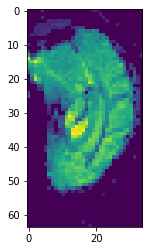

In [31]:
plt.imshow(rawimg[32,:,:,120])

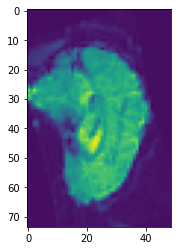

In [134]:
plt.imshow(prepimg[32,:,:,120])

In [37]:
rawimg[32,30,:,:].shape

(34, 240)

In [41]:
import numpy as np

In [250]:
confounds[[]].to_numpy().shape[-1] == 0


0

In [251]:
confounds.shape

(240, 236)

In [50]:
np.random.randint(139264)

40558

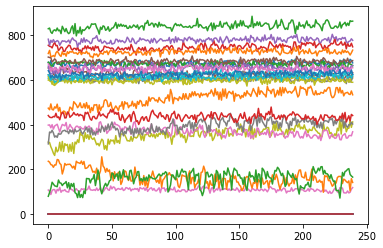

In [60]:
plt.plot(rawimg[32,30,:,:].T)
plt.show()

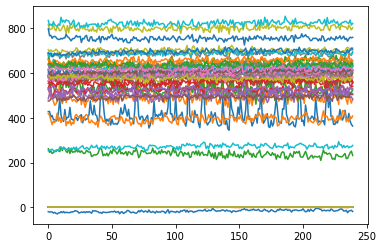

In [64]:
plt.plot(prepimg[32,30,:,:].T)
plt.show()

In [203]:
mni_mask = load_mni152_brain_mask().get_fdata()

In [204]:
m = mni_mask
zoom = (2,2,2)

In [205]:
m = block_reduce(m, zoom, np.mean)
m = 1 * (m > 0)

In [206]:
affine = load_mni152_brain_mask().affine.copy()

In [207]:
affine[0,:3] *= zoom[0]
affine[1,:3] *= zoom[1]
affine[2,:3] *= zoom[2]

In [208]:
affine

array([[  -4.,    0.,    0.,   90.],
       [   0.,    4.,    0., -126.],
       [   0.,    0.,    4.,  -72.],
       [   0.,    0.,    0.,    1.]])

In [209]:
voxel_mask = nib.Nifti1Image(m, affine=affine)
    
# masking is done by NiftiMasker provided by nilearn package
masker = NiftiMasker(mask_img=voxel_mask,
                     standardize=True,
                     smoothing_fwhm=None)

In [210]:
confound_names = ["trans_x", "trans_y",
                                      "trans_z", "rot_x", "rot_y", "rot_z"]

In [211]:
confounds = pd.read_table(confounds_path, sep="\t")
confounds = confounds[confound_names]
confounds = confounds.to_numpy()

In [218]:
confounds = pd.read_table(confounds_path, sep="\t")
confounds.keys()

Index(['csf', 'csf_derivative1', 'csf_power2', 'csf_derivative1_power2',
       'white_matter', 'white_matter_derivative1', 'white_matter_power2',
       'white_matter_derivative1_power2', 'global_signal',
       'global_signal_derivative1',
       ...
       'rot_x_power2', 'rot_x_derivative1_power2', 'rot_y',
       'rot_y_derivative1', 'rot_y_derivative1_power2', 'rot_y_power2',
       'rot_z', 'rot_z_derivative1', 'rot_z_derivative1_power2',
       'rot_z_power2'],
      dtype='object', length=236)

In [256]:
regressor = confounds.to_numpy()

In [262]:
regressor[np.isnan(regressor)] = 0

In [224]:
confounds.shape

(240, 236)

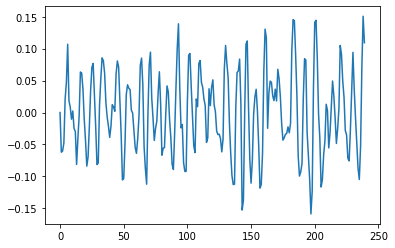

In [232]:
plt.plot(confounds['a_comp_cor_00'].to_numpy())

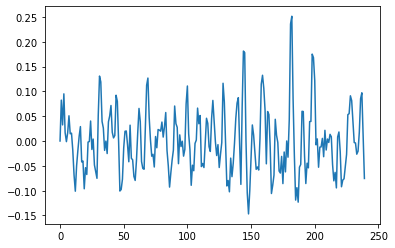

In [233]:
plt.plot(confounds['a_comp_cor_01'].to_numpy())

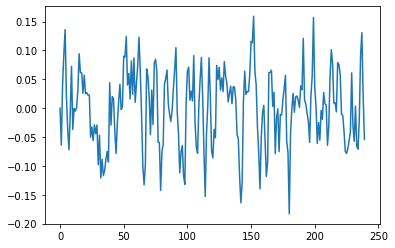

In [234]:
plt.plot(confounds['a_comp_cor_02'].to_numpy())

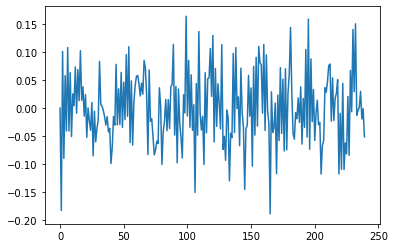

In [235]:
plt.plot(confounds['a_comp_cor_03'].to_numpy())

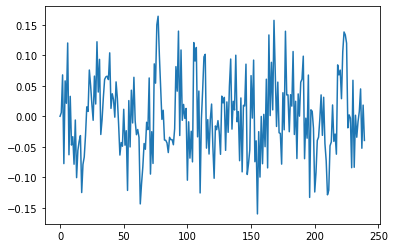

In [236]:
plt.plot(confounds['a_comp_cor_04'].to_numpy())

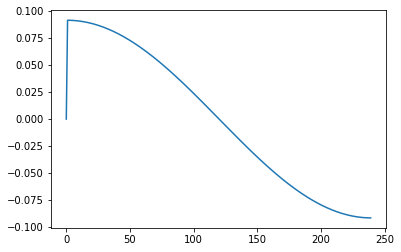

In [242]:
plt.plot(confounds['cosine00'].to_numpy())

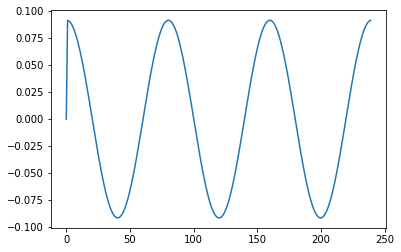

In [243]:
plt.plot(confounds['cosine05'].to_numpy())

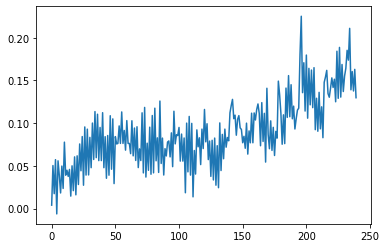

In [238]:
plt.plot(confounds['trans_y'].to_numpy())

In [263]:
confound_names = [name for name in list(confounds.columns) if '_comp_cor' not in name]

In [264]:
confound_names

['csf',
 'csf_derivative1',
 'csf_power2',
 'csf_derivative1_power2',
 'white_matter',
 'white_matter_derivative1',
 'white_matter_power2',
 'white_matter_derivative1_power2',
 'global_signal',
 'global_signal_derivative1',
 'global_signal_derivative1_power2',
 'global_signal_power2',
 'std_dvars',
 'dvars',
 'framewise_displacement',
 'rmsd',
 'cosine00',
 'cosine01',
 'cosine02',
 'cosine03',
 'cosine04',
 'cosine05',
 'non_steady_state_outlier00',
 'trans_x',
 'trans_x_derivative1',
 'trans_x_power2',
 'trans_x_derivative1_power2',
 'trans_y',
 'trans_y_derivative1',
 'trans_y_derivative1_power2',
 'trans_y_power2',
 'trans_z',
 'trans_z_derivative1',
 'trans_z_derivative1_power2',
 'trans_z_power2',
 'rot_x',
 'rot_x_derivative1',
 'rot_x_power2',
 'rot_x_derivative1_power2',
 'rot_y',
 'rot_y_derivative1',
 'rot_y_derivative1_power2',
 'rot_y_power2',
 'rot_z',
 'rot_z_derivative1',
 'rot_z_derivative1_power2',
 'rot_z_power2']

In [222]:
list(confounds.columns)

['csf',
 'csf_derivative1',
 'csf_power2',
 'csf_derivative1_power2',
 'white_matter',
 'white_matter_derivative1',
 'white_matter_power2',
 'white_matter_derivative1_power2',
 'global_signal',
 'global_signal_derivative1',
 'global_signal_derivative1_power2',
 'global_signal_power2',
 'std_dvars',
 'dvars',
 'framewise_displacement',
 'rmsd',
 't_comp_cor_00',
 't_comp_cor_01',
 't_comp_cor_02',
 't_comp_cor_03',
 't_comp_cor_04',
 'a_comp_cor_00',
 'a_comp_cor_01',
 'a_comp_cor_02',
 'a_comp_cor_03',
 'a_comp_cor_04',
 'a_comp_cor_05',
 'a_comp_cor_06',
 'a_comp_cor_07',
 'a_comp_cor_08',
 'a_comp_cor_09',
 'a_comp_cor_10',
 'a_comp_cor_11',
 'a_comp_cor_12',
 'a_comp_cor_13',
 'a_comp_cor_14',
 'a_comp_cor_15',
 'a_comp_cor_16',
 'a_comp_cor_17',
 'a_comp_cor_18',
 'a_comp_cor_19',
 'a_comp_cor_20',
 'a_comp_cor_21',
 'a_comp_cor_22',
 'a_comp_cor_23',
 'a_comp_cor_24',
 'a_comp_cor_25',
 'a_comp_cor_26',
 'a_comp_cor_27',
 'a_comp_cor_28',
 'a_comp_cor_29',
 'a_comp_cor_30',
 'a_co

In [212]:
fmri_masked = resample_to_img(str(prepimg_path), voxel_mask)

In [213]:
fmri_masked.get_fdata().shape

(46, 55, 46, 240)

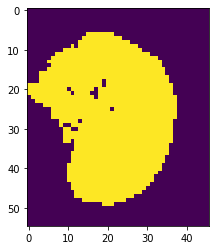

In [214]:
plt.imshow(m[22,:,:])

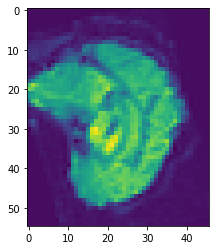

In [215]:
plt.imshow(fmri_masked.get_fdata()[22,:,:,120])

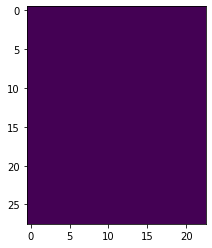

In [178]:
plt.imshow(fmri_masked.get_fdata()[11,:,:,120])

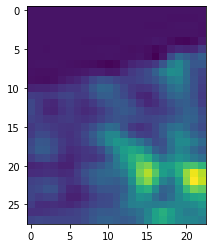

In [151]:
plt.imshow(fmri_masked.get_fdata()[11,:,:,120])

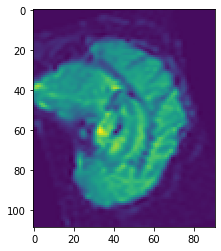

In [143]:
plt.imshow(fmri_masked.get_fdata()[45,:,:,120])

In [ ]:
plt.imshow(fmri_masked.get_fdata()[2,:,:,1])

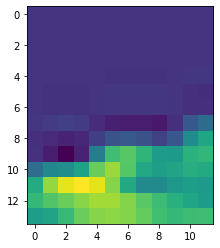

In [135]:
plt.imshow(fmri_masked.get_fdata()[2,:,:,120])

In [79]:
maskedimg_path = layout.derivatives['MB-MVPA'].get(subject='01',run='2',suffix='voxelfeatureall')[0]

In [80]:
maskedimg = np.load(maskedimg_path)

In [81]:
maskedimg.shape

(240, 30665)

In [90]:
size= 100

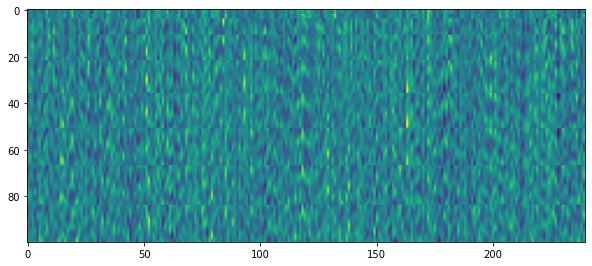

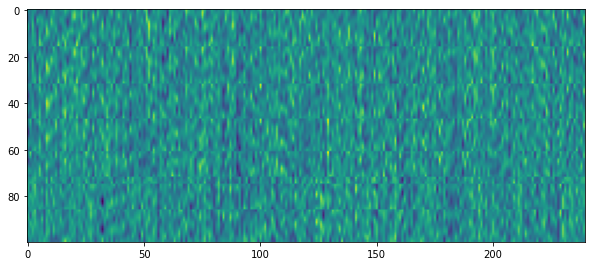

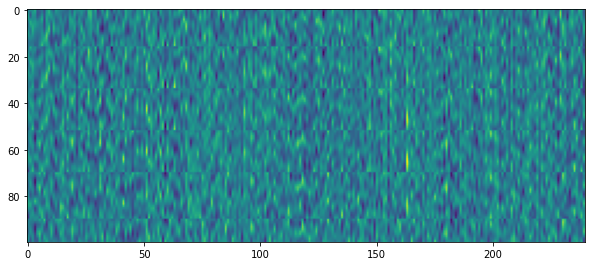

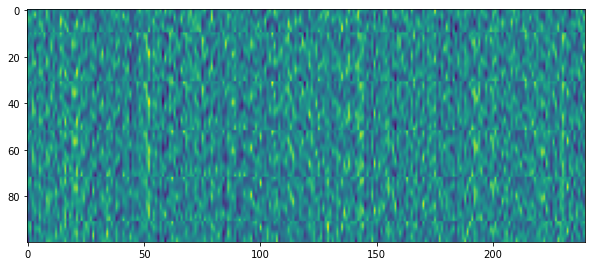

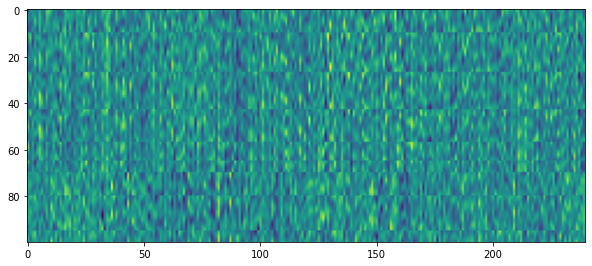

...

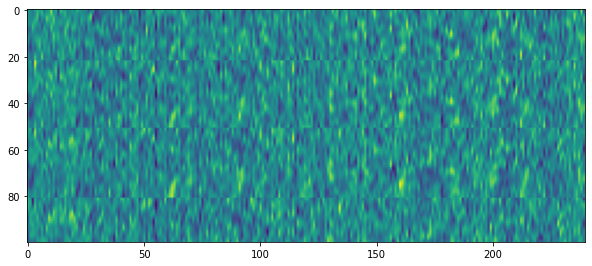

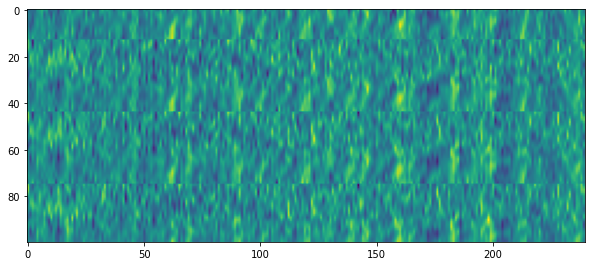

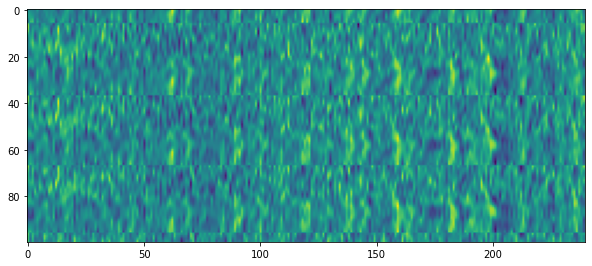

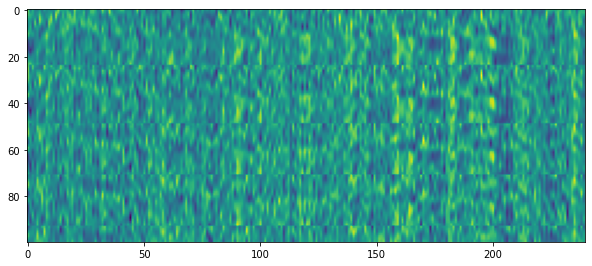

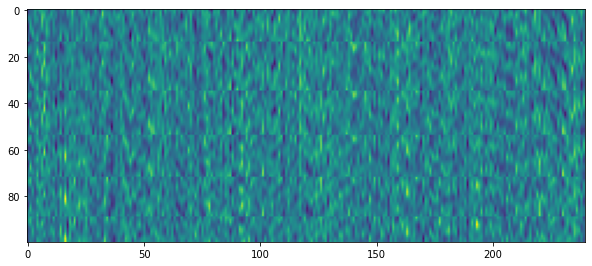

In [91]:
for i in range(100):
    plt.figure(figsize=(10,10))
    plt.imshow(maskedimg[:,size*i:size*(i+1)].T)
    plt.show()

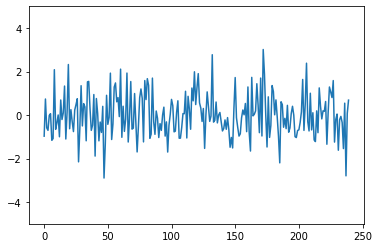

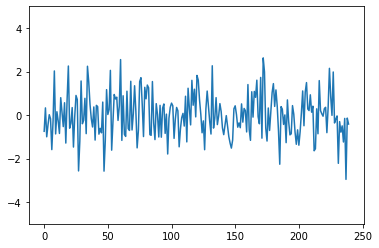

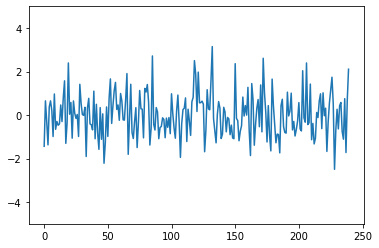

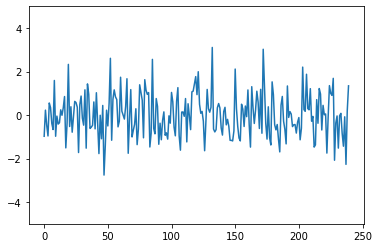

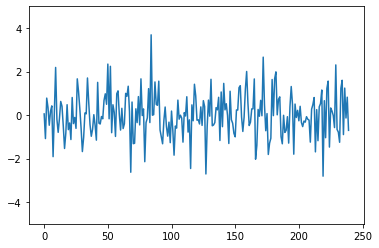

...

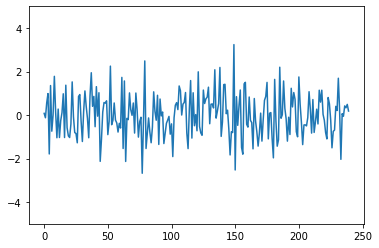

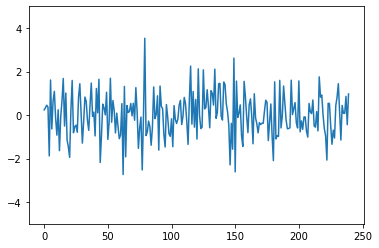

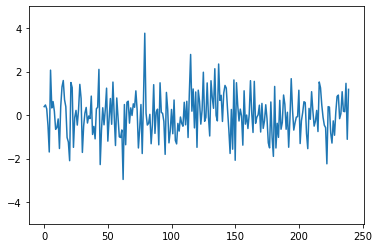

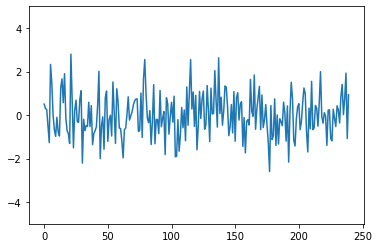

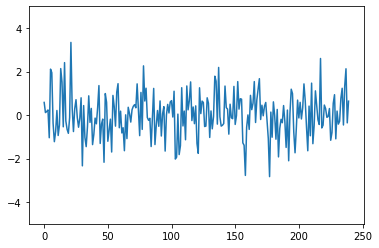

In [82]:
for i in range(10):
    plt.plot(maskedimg[:,1*i:1*i + 10])
    plt.ylim(-5,5)
    plt.show()